In [2]:
import os
import anndata as ad
import scanpy as sc
import pandas as pd
import numpy as np
import json
from typing import Dict, List, Optional, Union
from matplotlib.pyplot import imread
import liana as li
import decoupler as dc
import omnipath
import novae
import torch

from gbmhackathon.utils.visium_functions import (
    normalize_anndata_wrapper,
    convert_obsm_to_adata
)
from gbmhackathon.viz.visium_functions import (
    plot_spatial_expression,
    plot_obsm
)
from gbmhackathon.stats.visium_functions import (
    perform_multi_clustering,
    quantify_cell_population_activity
)
from gbmhackathon import MosaicDataset

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 1200



# Importating the data

In [3]:
visium_dict = MosaicDataset.load_visium(
    sample_list=["HK_G_022a_vis", "HK_G_024a_vis", "HK_G_030a_vis"], # remove this argument to load all available samples)
    resolution="hires"
)

Resolution of the spatial image to load:  hires
You can change the resolution by setting the resolution parameter using the resolution argument.
Loading Visium data, this can take few minutes...


/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, c

Recommended normalization from the visium_starter_mosaic notebook

In [4]:
visium_obj = normalize_anndata_wrapper(visium_dict, target_sum=1e6)

## Test to do the inference on a unique annData Matrix

In [76]:
one_visium_file = visium_obj["HK_G_024a_vis"]

In [77]:
one_visium_file

AnnData object with n_obs × n_vars = 4576 × 16927
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial', 'log1p'
    obsm: 'spatial'
    layers: 'raw', 'CPM', 'log_CPM'

In [78]:
one_visium_file.var

,gene_ids,feature_types,genome
SAMD11,ENSG00000187634,Gene Expression,GRCh38
NOC2L,ENSG00000188976,Gene Expression,GRCh38
KLHL17,ENSG00000187961,Gene Expression,GRCh38
PLEKHN1,ENSG00000187583,Gene Expression,GRCh38
PERM1,ENSG00000187642,Gene Expression,GRCh38
...,...,...,...
MT-ND4L,ENSG00000212907,Gene Expression,GRCh38
MT-ND4,ENSG00000198886,Gene Expression,GRCh38
MT-ND5,ENSG00000198786,Gene Expression,GRCh38
MT-ND6,ENSG00000198695,Gene Expression,GRCh38


In [79]:
one_visium_file.layers

Layers with keys: raw, CPM, log_CPM

In [80]:
one_visium_file.layers["raw"].toarray()

array([[ 0.,  0.,  0., ...,  7., 11., 16.],
       [ 0.,  0.,  0., ...,  8., 24., 42.],
       [ 0.,  0.,  0., ...,  4.,  3.,  5.],
       ...,
       [ 0.,  0.,  0., ..., 21., 34., 84.],
       [ 0.,  0.,  0., ...,  6., 11., 36.],
       [ 0.,  0.,  1., ..., 19., 43., 87.]], dtype=float32)

In [ ]:
plot_obsm(one_visium_file,"spatial")

/home/ec2-user/SageMaker/.conda/envs/gbmhackathon/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.


Specification of the different layers : 


We need first to prune the spatial connectivities of the data using Novae dataset:

In [82]:
novae.utils.spatial_neighbors(one_visium_file,radius = 10, technology ="visium")

[INFO] (novae.utils._build) Computing graph on 4,576 cells (coord_type=grid, delaunay=False, radius=[0.0, 10.0], n_neighs=6)


In [83]:
one_visium_file #Should have the 'spatial_connectivities' field in the obsp

AnnData object with n_obs × n_vars = 4576 × 16927
    obs: 'in_tissue', 'array_row', 'array_col', 'novae_sid'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial', 'log1p', 'spatial_neighbors'
    obsm: 'spatial'
    layers: 'raw', 'CPM', 'log_CPM'
    obsp: 'spatial_connectivities', 'spatial_distances'

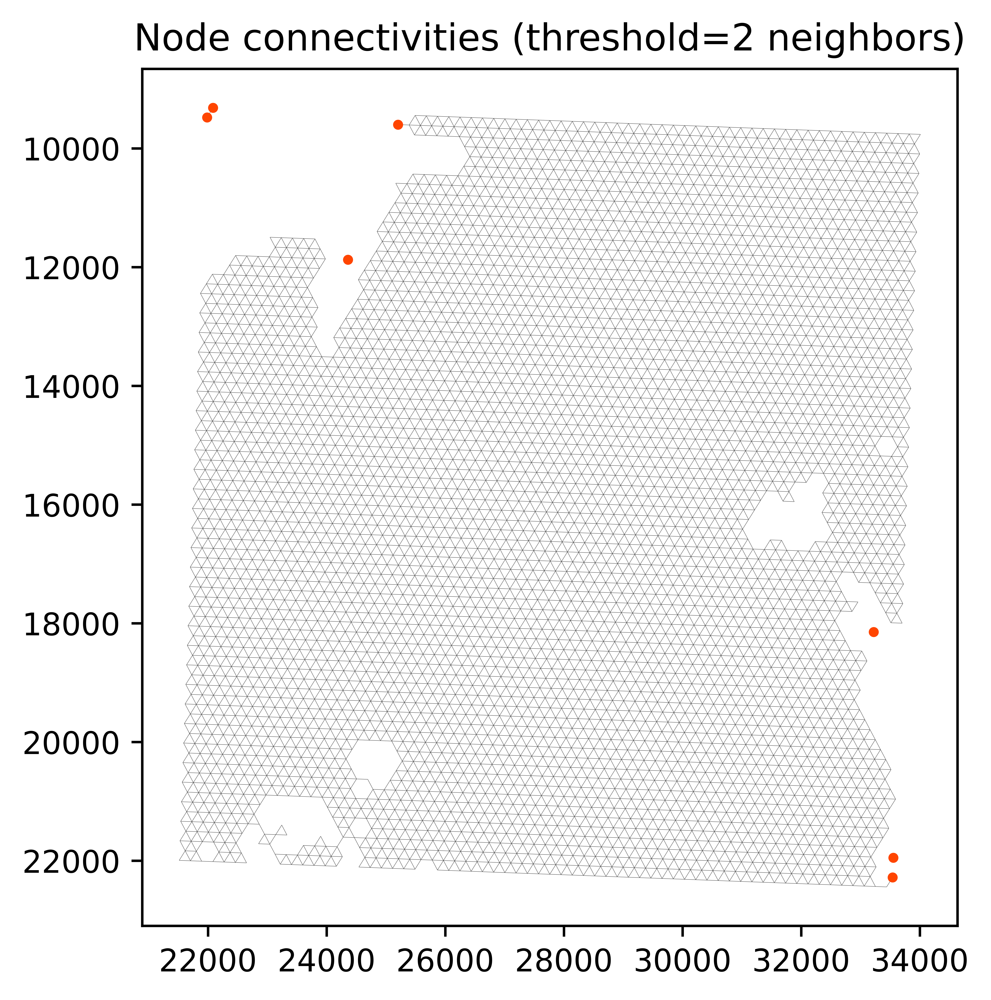

In [84]:
novae.plot.connectivities(one_visium_file)

In [14]:
novae_model = novae.Novae.from_pretrained("MICS-Lab/novae-human-0")

In [85]:
novae_model.compute_representations(one_visium_file, zero_shot = True)

[WARNING] (novae.utils._validate) adata.X has high values. We recommend processing the data before running the model (e.g., with sc.pp.log1p).


Computing representations:   0%|          | 0/9 [00:00<?, ?it/s]

In [86]:
one_visium_file

AnnData object with n_obs × n_vars = 4576 × 16927
    obs: 'in_tissue', 'array_row', 'array_col', 'novae_sid', 'neighborhood_valid', 'novae_leaves'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'in_vocabulary', 'novae_use_gene'
    uns: 'spatial', 'log1p', 'spatial_neighbors', 'hvg'
    obsm: 'spatial', 'novae_latent'
    layers: 'raw', 'CPM', 'log_CPM'
    obsp: 'spatial_connectivities', 'spatial_distances', 'spatial_distances_local', 'spatial_distances_pair'

In [87]:
novae_model.assign_domains(one_visium_file)

'novae_domains_7'

In [88]:
one_visium_file.obsm['novae_latent'].shape

(4576, 64)

In [35]:
one_visium_file.obsp['spatial_connectivities']

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 12514 stored elements and shape (2236, 2236)>

In [34]:
one_visium_file.obsp['spatial_distances']

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 12514 stored elements and shape (2236, 2236)>

In [ ]:
pyg_data=pytorch.geometric.Data(

In [36]:
one_visium_file.obs['novae_sid']

AACACTTGGCAAGGAA-1    139957554795744
AACAGGATTCATAGTT-1    139957554795744
AACAGGTTATTGCACC-1    139957554795744
AACAGGTTCACCGAAG-1    139957554795744
AACATAGTCTATCTAC-1    139957554795744
                           ...       
TGTTGCGTCCAAGATT-1    139957554795744
TGTTGGAACCTTCCGC-1    139957554795744
TGTTGGAACGAGGTCA-1    139957554795744
TGTTGGATGGACTTCT-1    139957554795744
TGTTGGCCAGACCTAC-1    139957554795744
Name: novae_sid, Length: 2236, dtype: category
Categories (1, int64): [139957554795744]

In [56]:
graph_encoder=novae.module.AttentionAggregation(64)

In [58]:
graph_encoder(torch.from_numpy(one_visium_file.obsm['novae_latent']))

tensor([[ 0.2585, -0.0446,  0.1195,  0.4311, -0.0146,  0.2559,  0.3332,  0.0426,
          0.1399, -0.0294,  0.2511, -0.0332,  0.0105,  0.1381, -0.1729, -0.0835,
         -0.0834,  0.0365, -0.1536, -0.1744,  0.1868,  0.1270, -0.1632,  0.0277,
          0.0586,  0.0275, -0.0423, -0.1755,  0.4012, -0.1438,  0.1541, -0.0082,
         -0.0738, -0.1367,  0.1370,  0.1274,  0.2156,  0.0323, -0.2397, -0.1207,
          0.1207, -0.0206, -0.0115, -0.0596,  0.0023, -0.1503, -0.0569, -0.0924,
         -0.3031, -0.2261, -0.0146,  0.2932,  0.1228, -0.0376,  0.1119,  0.0275,
          0.0180, -0.0496, -0.0928, -0.3709,  0.2412,  0.1782, -0.2369, -0.0860]],
       grad_fn=<ScatterAddBackward0>)

In [59]:
dir(graph_encoder)

['CHECKPOINT_HYPER_PARAMS_KEY',
 'CHECKPOINT_HYPER_PARAMS_NAME',
 'CHECKPOINT_HYPER_PARAMS_TYPE',
 'T_destination',
 '_LightningModule__check_allowed',
 '_LightningModule__check_not_nested',
 '_LightningModule__to_tensor',
 '__annotations__',
 '__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__jit_unused_properties__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_apply',
 '_apply_batch_transfer_handler',
 '_automatic_optimization',
 '_backward_hooks',
 '_backward_pre_hooks',
 '_buffers',
 '_call_batch_hook',
 '_call_impl',
 '_compiled_call_impl',
 '_compiler_ctx',
 '_current_fx_name',
 '_deterministic',
 '_device',
 '_device_mesh',
 '_dtype',
 '_ent

In [63]:
test = list(graph_encoder.parameters())

In [68]:
test

[Parameter containing:
 tensor([[ 8.6565e-02, -7.5673e-02,  1.8905e-02, -4.5508e-05, -1.0378e-02,
           2.9103e-02,  3.2897e-02, -6.3290e-02,  6.4091e-02,  3.1047e-02,
           1.0792e-01, -9.2107e-03, -1.1566e-02, -8.2409e-02, -1.2461e-01,
          -4.9186e-02,  4.0554e-02,  6.9686e-03,  2.9959e-02,  5.7958e-02,
          -2.1981e-02, -8.5064e-02,  1.1807e-01,  1.1014e-01, -1.0407e-01,
          -2.8756e-02,  3.2350e-02, -5.4410e-02, -1.0355e-01,  1.0582e-01,
           1.1414e-01,  7.4424e-02, -3.5336e-03, -5.8021e-02,  1.2372e-01,
           3.1556e-03, -7.5612e-02,  5.3084e-02, -9.4499e-02, -1.2330e-01,
           6.9176e-02,  6.6681e-02,  8.2731e-02,  5.1216e-02,  4.7122e-02,
           6.0388e-02,  5.5204e-02, -6.1705e-02, -1.0816e-01, -1.2200e-01,
          -1.2369e-02, -7.6823e-02,  6.4350e-02, -1.6802e-02, -4.5764e-02,
          -7.6856e-04,  8.1699e-02, -1.0040e-01, -4.8642e-02,  1.9204e-03,
           8.9400e-02, -1.2311e-02, -1.0051e-01, -1.0525e-03]],
        requi

In [71]:
for parameter in test : 
    print(parameter.shape) 

torch.Size([1, 64])
torch.Size([1])
torch.Size([64, 64])
torch.Size([64])


[INFO] (novae.utils._validate) Using obs_key='novae_domains_7' by default.
... storing 'novae_leaves' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical


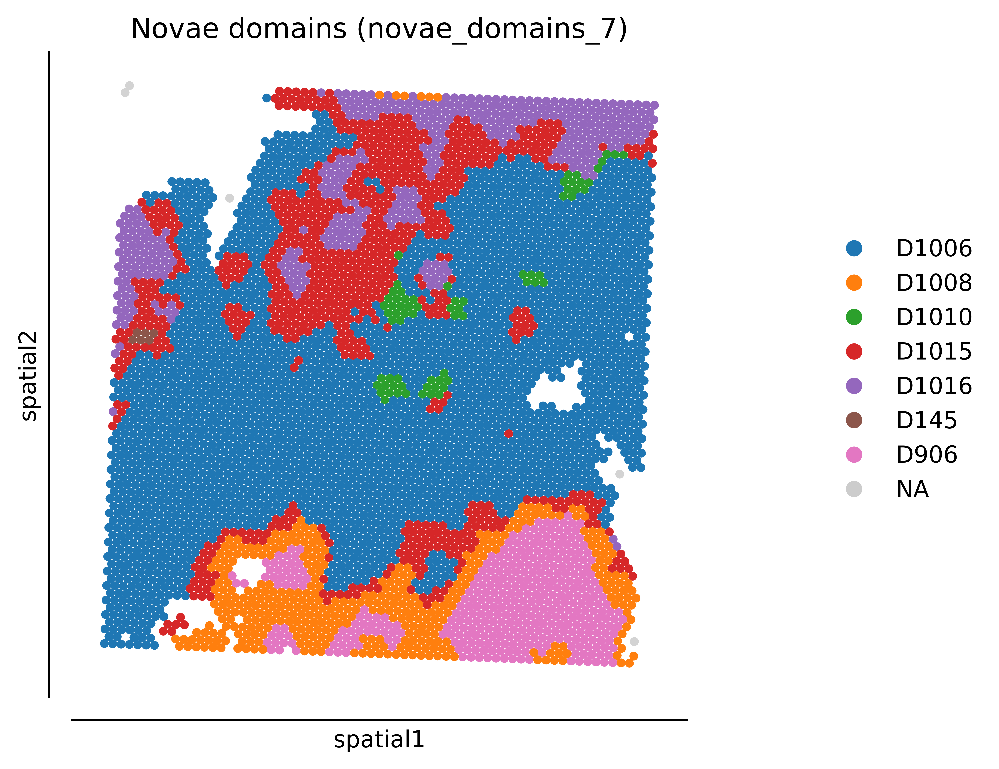

In [89]:
novae.plot.domains(one_visium_file,cell_size=200)

In [ ]:
visium_dict = MosaicDataset.load_visium(
    sample_list=["HK_G_022a_vis", "HK_G_024a_vis", "HK_G_030a_vis"], # remove this argument to load all available samples)
    resolution="hires"
)

visium_obj = normalize_anndata_wrapper(visium_dict, target_sum=1e6)
